## Systematic Trading model
### Ar(p) Model

In [17]:
# Imports :
import pandas as pd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.tsa.ar_model import AutoReg
import yfinance as yf
import plotly.graph_objects as go
import plotly.io as pio
import datetime as dt
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.seasonal import seasonal_decompose
pio.templates.default = "plotly_white"
from plotly.subplots import make_subplots


## Data recovery and some plots:

In [6]:
# Imports de capitalisations boursières des grandes entreprises du tourisme
def get_data(assets, start_date, end_date):
    """
    Récupère les données des actions sur Yahoo Finance
    """
    return yf.download(assets, start=start_date, end=end_date)['Adj Close']

defense_assets = ['MLHK.PA','BA.L','SAF.PA','DAA2.VI','LMT', 'NOC', 'RTX', 'GD', 'BA', 'BAES.L', 'AIR.PA', 'LDO.MI', 'HO.PA', 'HII', 'LHX', 'HON', 'SAAB-B.ST','RHM.DE']
basic_materials =['GOLD','BZ=F','SI=F','HG=F','NG=F','KC=F','ZC=F','ZO=F','KE=F','ZR=F','ZS=F','HE=F','LE=F','CC=F','CT=F','LBS=F','OJ=F']
automobile_assets=['TSLA','GM','F','RIVN','LOT','7201.T','RNO.PA','FR.PA','ML.PA','TM','HMC','NSANY','VWAGY','DDAIF','BMWYY','RACE','BWA','APTV','MGA','LEA','DLPH','VC','CTTAY','CLR','CMI','WBC','ALV','THRM','APTV','VLEEY','DAN','BWA','JCI','ADNT','CMI','WBC','XOM','RDS.A','CVX','BP','2222.SR','BRDCY','GT','CTTAY']
N = 6000 # Complétez avec le nombre de jours historiques

start_date = dt.datetime.now() - dt.timedelta(days=N)
end_date = dt.datetime.now()

basic_materials_data=get_data(basic_materials, start_date,end_date)
defense_data = get_data(defense_assets, start_date, end_date)
automobile_data= get_data(automobile_assets,start_date,end_date)
#defense_data = defense_data.drop(defense_data.index[-1])
defense_data


[*********************100%%**********************]  17 of 17 completed
[*********************100%%**********************]  18 of 18 completed
[*********************100%%**********************]  39 of 39 completed

5 Failed downloads:
['DLPH', 'RDS.A', 'CLR', 'WBC', 'DDAIF']: YFTzMissingError('$%ticker%: possibly delisted; No timezone found')


Ticker,AIR.PA,BA,BA.L,BAES.L,DAA2.VI,GD,HII,HO.PA,HON,LDO.MI,LHX,LMT,MLHK.PA,NOC,RHM.DE,RTX,SAAB-B.ST,SAF.PA
Date,,,,,,,,,,,,,,,,,,
2008-01-02,17.343302,63.481625,241.360901,NaN,NaN,59.421745,NaN,27.824854,39.138420,15.529970,40.821373,63.540924,NaN,49.360142,34.094883,31.808920,7.801584,10.352485
2008-01-03,17.278318,63.745476,245.058960,NaN,NaN,60.142082,NaN,27.845551,39.334435,15.436887,41.012703,65.097061,NaN,49.787174,33.478298,32.261452,7.786496,10.180563
2008-01-04,16.855904,62.895306,236.183670,NaN,NaN,58.443153,NaN,27.942139,38.079922,15.193450,39.963646,64.234558,NaN,49.517120,32.014774,31.728550,7.545051,9.844204
2008-01-07,15.596789,60.733341,236.676682,NaN,NaN,58.381985,NaN,27.093527,37.949230,14.899888,38.300976,64.089813,NaN,49.039860,31.303326,31.580530,7.348882,9.642385
2008-01-08,15.726762,58.564030,242.593567,NaN,NaN,58.191723,NaN,27.217710,37.302368,14.842611,37.496014,64.113907,NaN,47.984837,31.235573,30.362492,7.424332,9.403194
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-30,159.100006,172.750000,1373.000000,4.85400,194.899994,296.079987,249.919998,164.300003,200.910004,23.090000,218.048279,457.852936,116.0,446.519989,516.599976,105.720001,240.000000,213.800003
2024-05-31,155.899994,177.610001,1392.000000,4.83100,196.300003,299.769989,253.100006,166.649994,202.190002,23.570000,223.679321,467.190002,115.0,450.769989,527.799988,107.809998,253.399994,214.100006
2024-06-03,155.300003,184.570007,1395.500000,4.62000,200.399994,298.260010,250.380005,167.500000,202.460007,24.139999,225.489990,467.600006,115.0,449.329987,535.000000,107.370003,256.500000,215.399994


In [7]:
# Création d'un quadrillage de subplots 2x2
fig = make_subplots(rows=2, cols=2, subplot_titles=(
    'Evolution des prix des actifs défense',
    'Evolution des prix des actifs matériaux bruts',
    'Evolution des prix des actifs automobile',
   ))

# Ajout des traces pour les actifs de défense
for a in defense_assets:
    fig.add_trace(go.Scatter(x=defense_data.index, y=defense_data[a], name=a),
                  row=1, col=1)

# Ajout des traces pour les actifs matériaux bruts
for a in basic_materials:
    fig.add_trace(go.Scatter(x=basic_materials_data.index, y=basic_materials_data[a], name=a),
                  row=1, col=2)

# Ajout des traces pour les actifs automobile
for a in automobile_assets:
    fig.add_trace(go.Scatter(x=automobile_data.index, y=automobile_data[a], name=a),
                  row=2, col=1)



# Mise à jour de la mise en page
fig.update_layout(title_text='Evolution des prix des actifs par catégorie', showlegend=False)

# Affichage du graphique
fig.show()


In [8]:
fig = go.Figure()
for a in defense_assets:
    fig.add_trace(go.Scatter(x=defense_data.index, y=defense_data[a], name=a))
fig.update_layout(title='Evolution des prix des actifs défense', yaxis_title='Prix en $')
fig.show()

In [9]:
defense_data.index = pd.to_datetime(defense_data.index)
automobile_data.index = pd.to_datetime(automobile_data.index)
basic_materials_data.index = pd.to_datetime(basic_materials_data.index)

defense_data = defense_data.resample('M').mean()
automobile_data =automobile_data.resample('M').mean()
basic_materials_data=basic_materials_data.resample('M').mean()


# Calcul des rendements logarithmiques quotidiens pour chaque colonne
defense_returns = np.log(defense_data/ defense_data.shift(1))

# Renommer les colonnes pour indiquer qu'il s'agit de rendements logarithmiques
defense_returns.columns = [col + '_log_return' for col in defense_data.columns]

automobile_returns = np.log(automobile_data / automobile_data.shift(1))
automobile_returns.columns = [col + '_log_return' for col in automobile_data.columns]

basic_materials_return = np.log(basic_materials_data / basic_materials_data.shift(1))
basic_materials_return.columns = [col + '_log_return' for col in basic_materials_data.columns]



/var/folders/95/b7t5chdd7sx2c8x5m_kmybrh0000gn/T/ipykernel_17227/4239131554.py:5: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.

/var/folders/95/b7t5chdd7sx2c8x5m_kmybrh0000gn/T/ipykernel_17227/4239131554.py:6: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.

/var/folders/95/b7t5chdd7sx2c8x5m_kmybrh0000gn/T/ipykernel_17227/4239131554.py:7: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



## Factors series:
In the case of the defense industry:

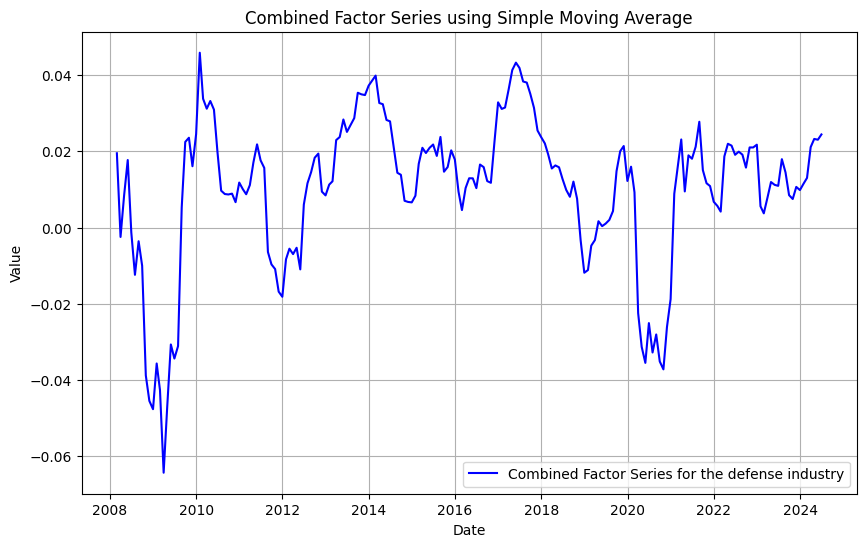

In [10]:
# Factor series using simple moving average
def calculate_sma(series, window=10):
    return series.rolling(window=window, min_periods=1).mean()  

facser = defense_returns.apply(calculate_sma)
comb_facser = facser.mean(axis=1)  

tick_frequency = 24
plt.figure(figsize=(10, 6))
plt.plot(comb_facser.index, comb_facser.values, label='Combined Factor Series for the defense industry', color='blue')
plt.title('Combined Factor Series using Simple Moving Average')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.grid(True)

plt.show()

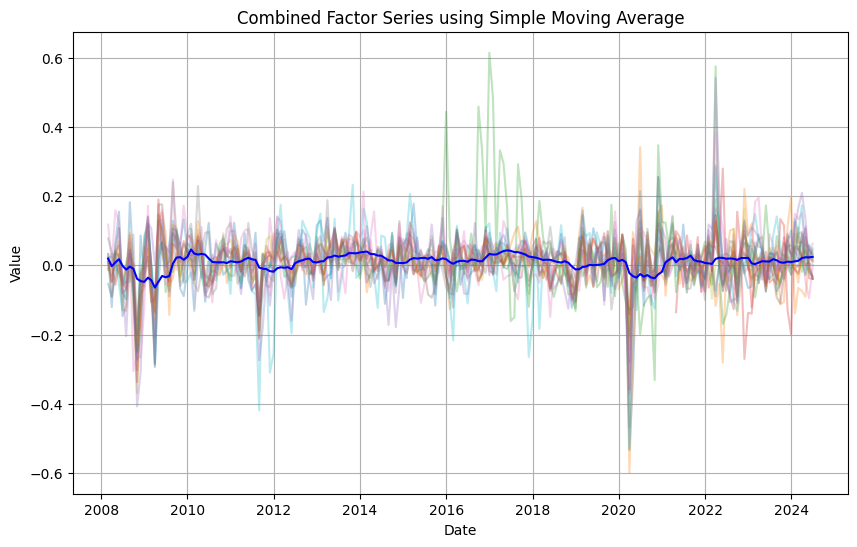

In [11]:
# Comparison of factor series with individual factors
plt.figure(figsize=(10, 6))
for column in defense_returns.columns:
    plt.plot(defense_returns.index, defense_returns[column].values, label=column, alpha=0.3)  
plt.plot(comb_facser.index, comb_facser.values, label='Combined Factor Series', color='blue')
plt.title('Combined Factor Series using Simple Moving Average')
plt.xlabel('Date')
plt.ylabel('Value')
plt.grid(True)
plt.show()

## AR(p) model: 

An autoregressive model of order \( p \), denoted AR(p), is used to model time series. In this model, the current value of the series is determined by its \( p \) previous values and an error term.

-----
#### __Basic Form of the AR(p) Model__
The general form of an AR(p) model is:

$$
X_t = c + \phi_1 X_{t-1} + \phi_2 X_{t-2} + \ldots + \phi_p X_{t-p} + \epsilon_t
$$


- $X_t$: current value of the series
- $c$: constant
-  $\phi_1, \phi_2, \ldots, \phi_p $: model parameters
- $\epsilon_t$: error term

It is important to note that the AR model works only with stationary time series. Therefore, \( X_t \) cannot be the closing price but rather the return of the series. Here, we're going to work with the log-returns, defined as: 

$$
X_t = \text{Log-Return}_t = \log\left(\frac{P_t}{P_{t-1}}\right)
$$


In [104]:
# Data split

train_size = 0.7
data_train = defense_returns.copy().iloc[: int(train_size * len(defense_returns))]
data_test = defense_returns.copy().iloc[int(train_size * len(defense_returns)) :]

In [105]:
def best_ar_order(time_series, max_lag):
    best_aic = np.inf
    best_bic = np.inf
    best_p_aic = None
    best_p_bic = None
    
    for p in range(1, max_lag + 1):
        model = AutoReg(time_series, lags=p).fit()
        aic = model.aic
        bic = model.bic
        
        if aic < best_aic:
            best_aic = aic
            best_p_aic = p
            
        if bic < best_bic:
            best_bic = bic
            best_p_bic = p
    
    return best_p_aic, best_p_bic, best_aic, best_bic

In [106]:
best_aic_tot = np.inf
best_bic_tot = np.inf
best_p_aic_tot = None
best_p_bic_tot = None
max_lag = 20 # Maximum AR order to consider

for column in data_train.columns:
    time_series = data_train[column].dropna()
    if len(time_series) > max_lag:  # avoid the case where the time series is too short
        best_p_aic, best_p_bic, best_aic, best_bic = best_ar_order(time_series, max_lag)
        if best_aic < best_aic_tot:
            best_aic_tot = best_aic
            best_p_aic_tot = best_p_aic
        if best_bic < best_bic_tot:
            best_bic_tot = best_bic
            best_p_bic_tot = best_p_bic

print('Best AIC order:', best_p_aic_tot)
print('Best BIC order:', best_p_bic_tot)

Best AIC order: 10
Best BIC order: 2


We are going to take $p = 2$ for our Ar(p) model.

### __Creation of Lagged Columns__

In [107]:
p = 2  # AR order
lags = list(range(1, p+1))

for lag in lags:
    for column in data_train.columns:
        data_train[column + '_lag' + str(lag)] = data_train[column].shift(lag)
        data_test[column + '_lag' + str(lag)] = data_test[column].shift(lag)



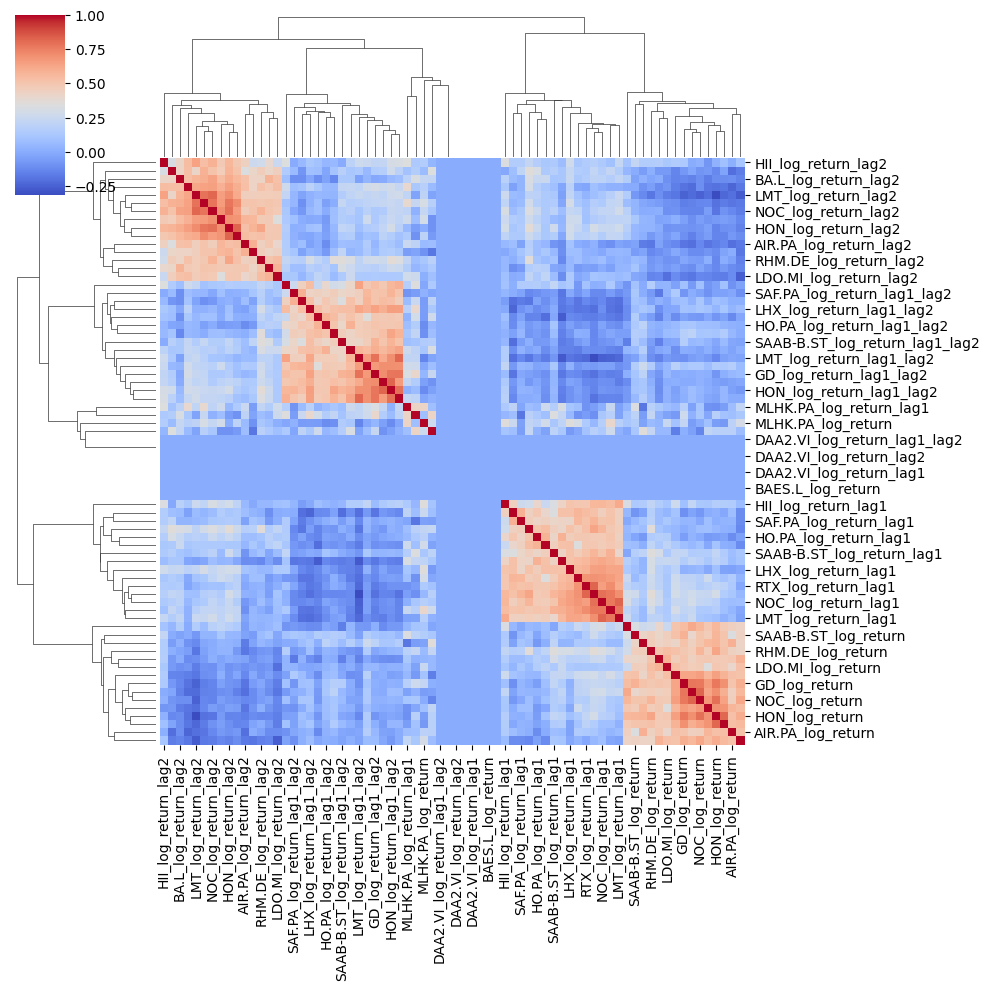

In [108]:
# correlation matrix
import seaborn as sns
sns.clustermap(data_train[[c for c in data_train.columns if 'return' in c]].corr().replace([np.inf, -np.inf], np.nan).fillna(0), annot=False, fmt=".2f", cmap="coolwarm")

### __Model Training__

In [109]:
from statsmodels.api import OLS, add_constant
Y = data_train[[c for c in data_train.columns if 'lag' not in c]].fillna(0)
X = add_constant(data_train[[c for c in data_train.columns if 'lag' in c]]).fillna(0)

phis = np.linalg.lstsq(X, Y, rcond=None)[0]

#------------------------------------
fig = go.Figure()
fig.add_trace(go.Bar(x=X.columns, y=phis))
fig.update_layout(title="Coefficients", xaxis_title="Lags", yaxis_title="Value")
fig.show()

In [110]:
#OLS import sklearn
from sklearn.linear_model import LinearRegression
models = {}
for column in Y.columns:
    model = LinearRegression()
    model.fit(X, Y[column])
    models[column] = model

In [111]:
for column in Y.columns:
    data_train[column + '_pred'] = models[column].predict(X)

<Axes: xlabel='Date'>

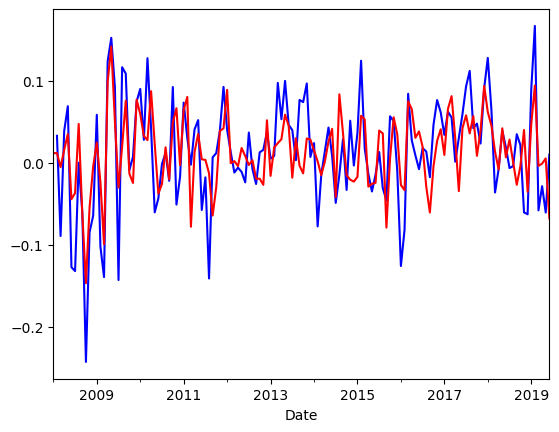

In [112]:
data_train.BA_log_return.plot(label='Actual', color='blue')
data_train.BA_log_return_pred.plot(label='Predicted', color='red')

<Axes: title={'center': 'Predictions vs Real Values'}, xlabel='Date'>

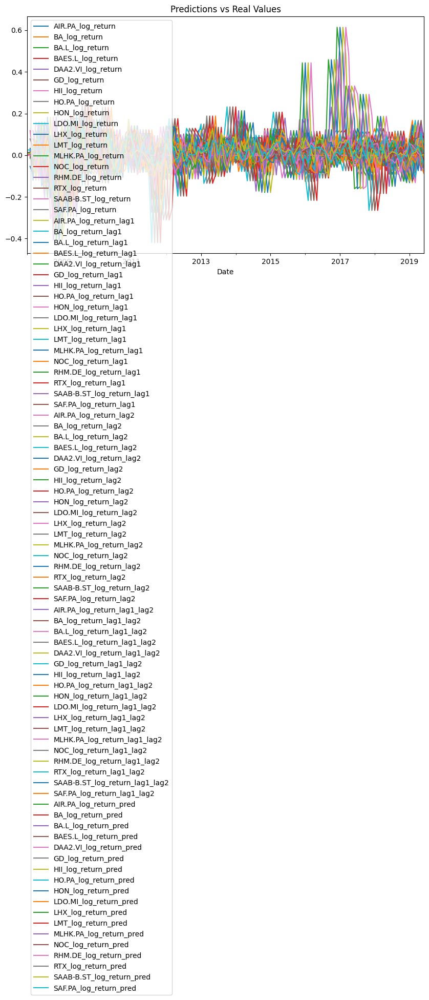

In [113]:
data_train[[c for c in data_train.columns if 'return' in c]].plot(figsize=(10, 6), title='Predictions vs Real Values')